###### 218090206 BODIRWA T





# PROJECT:    NYC TAXI TRIP DURATION





# 1. problem statement/definition

The goal is to predict the number of taxi trips that will occur within a specific time period based on the New York City taxi trip duration dataset. This analysis aims to develop a model that can accurately forecast demand for taxi services on a particular day and time, with the aim of optimizing taxi services and reducing waiting times.

# 2. Hypothesis Generation
###### The following are hypothesis the could be tested:

• Holidays and special events (e.g. concerts, sports games, parades) increase the demand for taxis.

• Distance affects taxi trips.

• Location affects taxi trips




# 3. List out all the variables that might affect the taxi trips based on the available dataset.


###### The following is a list of variables that could potentially impact taxi trips, based on the available dataset:

•Local events or holidays

•Traffic conditions

•Availability of other transportation options

•Distance travelled


# 4. Data collection

###### To collect data for analyzing and building medel for predicting taxi trips , we can start by gathering information on the following variables:

•Traffic conditions. 

•Distance travelled.

•Pick-up and drop-off location (longitude & latitude).

•Traffic conditions/weather condition.


This data can be collected  by acessing taxi logs and gps data, taxi drives and passengers through surveys and interviews.




# 5. Exploratory data ANALYSIS and transformation

##            The dataset variables description

###### Here is the description of all the variables / features available in the dataset which will help you to perform EDA: 

• id-a unique identifier for each trip.

• vendor_id - a code indicating the provider associated with the trip record.

• pickup_datetime - date and time when the meter was engaged dropoff_datetime - date and time when the meter was disengaged.

• passenger_count- the number of passengers in the vehicle (driver entered value). 

• pickup_longitude- the longitude where the meter was engaged. 

• pickup_latitude - the latitude where the meter was engaged dropoff_longitude - the longitude where the meter was disengaged.

• dropoff_latitude - the latitude where the meter was disengaged.

• store_and_fwd_flag - This flag indicates whether the trip record was held in vehicle memory before sending to the vendor because.

the vehicle did not have a connection to the server (Y=store and forward; N=not a store and forward trip).

• trip_duration - (target) duration of the trip in seconds.







In [1]:
!pip install sklearn

!pip install folium

!pip install pandas


Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable
Defaulting to user installation because normal site-packages is not writeable


In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap




## File structure and content & Data Types

In [3]:
data = pd.read_csv("nyc_taxi_trip_duration.csv")
data.head(10)


,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,N,400
1,id0889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,N,1100
2,id0857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,N,1635
3,id3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,N,1141
4,id0232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,N,848
5,id1918069,2,2016-02-14 18:31:42,2016-02-14 18:55:57,2,-73.993614,40.751884,-73.995422,40.723862,N,1455
6,id2429028,1,2016-04-20 20:30:14,2016-04-20 20:36:51,1,-73.965080,40.758915,-73.976807,40.764107,N,397
7,id1663798,2,2016-06-19 16:48:14,2016-06-19 17:06:35,1,-73.963890,40.765434,-73.872429,40.774200,N,1101
8,id2436943,2,2016-03-28 19:17:03,2016-03-28 19:48:29,2,-73.872887,40.774281,-73.979019,40.761879,N,1886
9,id2933909,1,2016-04-10 22:01:41,2016-04-10 22:25:30,1,-73.987823,40.740982,-73.999153,40.686451,N,1429


In [4]:
data.tail()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
729317,id3905982,2,2016-05-21 13:29:38,2016-05-21 13:34:34,2,-73.965919,40.789780,-73.952637,40.789181,N,296
729318,id0102861,1,2016-02-22 00:43:11,2016-02-22 00:48:26,1,-73.996666,40.737434,-74.001320,40.731911,N,315
729319,id0439699,1,2016-04-15 18:56:48,2016-04-15 19:08:01,1,-73.997849,40.761696,-74.001488,40.741207,N,673
729320,id2078912,1,2016-06-19 09:50:47,2016-06-19 09:58:14,1,-74.006706,40.708244,-74.013550,40.713814,N,447
729321,id1053441,2,2016-01-01 17:24:16,2016-01-01 17:44:40,4,-74.003342,40.743839,-73.945847,40.712841,N,1224


In [5]:
data.shape

(729322, 11)

In [6]:
data.info

<bound method DataFrame.info of                id  vendor_id      pickup_datetime     dropoff_datetime   
0       id1080784          2  2016-02-29 16:40:21  2016-02-29 16:47:01  \
1       id0889885          1  2016-03-11 23:35:37  2016-03-11 23:53:57   
2       id0857912          2  2016-02-21 17:59:33  2016-02-21 18:26:48   
3       id3744273          2  2016-01-05 09:44:31  2016-01-05 10:03:32   
4       id0232939          1  2016-02-17 06:42:23  2016-02-17 06:56:31   
...           ...        ...                  ...                  ...   
729317  id3905982          2  2016-05-21 13:29:38  2016-05-21 13:34:34   
729318  id0102861          1  2016-02-22 00:43:11  2016-02-22 00:48:26   
729319  id0439699          1  2016-04-15 18:56:48  2016-04-15 19:08:01   
729320  id2078912          1  2016-06-19 09:50:47  2016-06-19 09:58:14   
729321  id1053441          2  2016-01-01 17:24:16  2016-01-01 17:44:40   

        passenger_count  pickup_longitude  pickup_latitude  dropoff_longitude  

## Detect the missing values 

In [7]:
#========check missing values=========
data.isnull().sum()

id                    0
vendor_id             0
pickup_datetime       0
dropoff_datetime      0
passenger_count       0
pickup_longitude      0
pickup_latitude       0
dropoff_longitude     0
dropoff_latitude      0
store_and_fwd_flag    0
trip_duration         0
dtype: int64

In [8]:
data.duplicated().sum()

0

In [9]:
data.describe()

,vendor_id,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,trip_duration
count,729322.000000,729322.000000,729322.000000,729322.000000,729322.000000,729322.000000,7.293220e+05
mean,1.535403,1.662055,-73.973513,40.750919,-73.973422,40.751775,9.522291e+02
std,0.498745,1.312446,0.069754,0.033594,0.069588,0.036037,3.864626e+03
min,1.000000,0.000000,-121.933342,34.712234,-121.933304,32.181141,1.000000e+00
25%,1.000000,1.000000,-73.991859,40.737335,-73.991318,40.735931,3.970000e+02
50%,2.000000,1.000000,-73.981758,40.754070,-73.979759,40.754509,6.630000e+02
75%,2.000000,2.000000,-73.967361,40.768314,-73.963036,40.769741,1.075000e+03
max,2.000000,9.000000,-65.897385,51.881084,-65.897385,43.921028,1.939736e+06


## Reformatting features & Checking consistency(1. converting strings to datetime features, 2. Converting yes/no flag to 1 and 0

In [10]:
#converting converting strings to datetime features
data['pickup_datetime'] = pd.to_datetime(data['pickup_datetime'])
data['dropoff_datetime'] = pd.to_datetime(data['dropoff_datetime'])

In [11]:
#Converting yes/no flag to 1 and 0
#data['store_and_fwd_flag'] = data['store_and_fwd_flag'].map({'N' : 0 , 'Y' : 1})
data["store_and_fwd_flag"] = data["store_and_fwd_flag"].apply(lambda x: 1 if x == "Y" else 0)
data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration
0,id1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,0,400
1,id0889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,0,1100
2,id0857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,0,1635
3,id3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,0,1141
4,id0232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,0,848


## Target Exploration(count ,mean, std, min, 25%, 50%, 75%,& max )

In [12]:
#=====Target Exploration(count ,mean, std, min, 25%, 50%, 75%,& max)=====
data['trip_duration'].describe()

count    7.293220e+05
mean     9.522291e+02
std      3.864626e+03
min      1.000000e+00
25%      3.970000e+02
50%      6.630000e+02
75%      1.075000e+03
max      1.939736e+06
Name: trip_duration, dtype: float64

## #Log trip_duration and plot your result as pdf.

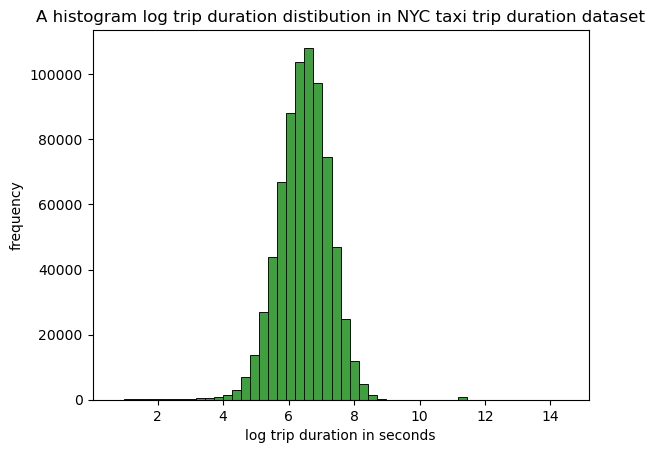

<Figure size 640x480 with 0 Axes>

In [13]:
#=====Log trip_duration and plot your result as pdf.======


data['log_trip_duration'] = np.log(data['trip_duration'].values + 1)

sns.histplot(data['log_trip_duration'], bins=50  ,color='green')
plt.xlabel('log trip duration in seconds')
plt.ylabel('frequency')
plt.title("A histogram log trip duration distibution in NYC taxi trip duration dataset")
plt.show()
plt.savefig('trip_duration_histogram.pdf')


## Carry out the following Univariate Visualization again individual frequency (passenger count, vendor ID, store and forward flag) and explain your observation 

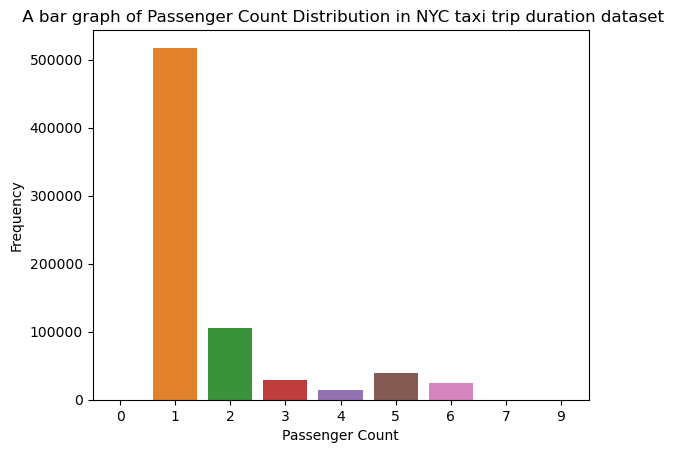

In [14]:
#========following Univariate:passenger count======== 

sns.countplot(x = 'passenger_count', data=data)
plt.title(' A bar graph of Passenger Count Distribution in NYC taxi trip duration dataset')
plt.xlabel('Passenger Count')
plt.ylabel('Frequency')
plt.show()


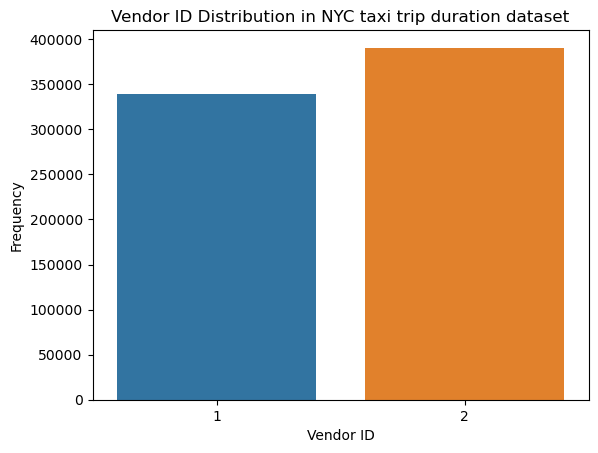

In [96]:
#=========Univariate Visualization :vendor ID===========

sns.countplot(x='vendor_id', data=data)
plt.title('Vendor ID Distribution in NYC taxi trip duration dataset')
plt.xlabel('Vendor ID')
plt.ylabel('Frequency')
plt.show()

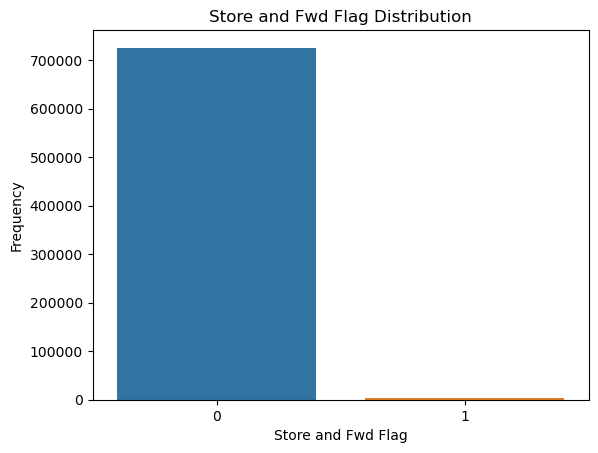

In [15]:
#===========Univariate Visualization : store and forward flag==============
sns.countplot(x='store_and_fwd_flag', data=data)
plt.title('Store and Fwd Flag Distribution')
plt.xlabel('Store and Fwd Flag')
plt.ylabel('Frequency')
plt.show()

# observations

###### Observations on Passenger Count:

• The majority of trips had only one passenger which is approximately 70%.

• Travel arrangements involving more than 7 passengers were very rare, accounting for less than 1% of the sample.

• The dataset contains a maximum of nine passengers that were observed.

###### Observations on Vendor ID:

• There are two vendor IDs present in the dataset (1 & 2).

• Vendor ID 2 had a slightly higher trip count than Vendor ID 1.

##### Observations on Store and Forward Flag:

• Most of the trips in the dataset had a store and forward flag value of 0.

• The median trip duration for trips with a store and forward flag value of 1 which was higher than for 
    those with a value of 0, and the difference is vety huge.

• Trips with a store and forward flag value of 1 were relatively rare, making up less than 1% of the dataset.


In [16]:
data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,log_trip_duration
0,id1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,0,400,5.993961
1,id0889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,0,1100,7.003974
2,id0857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,0,1635,7.400010
3,id3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,0,1141,7.040536
4,id0232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,0,848,6.744059


 VIII. Find your pickup time in week day and hour and plot them again total number of pickup.

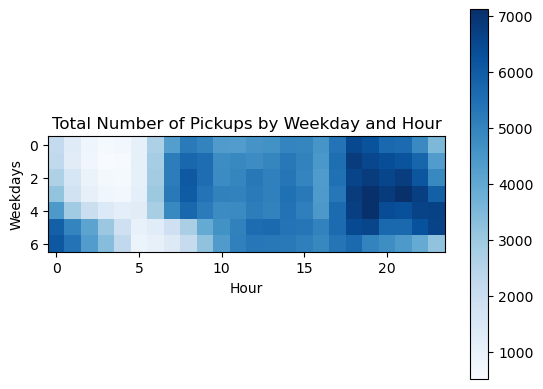

In [18]:


data["pickup_weekday"] = data["pickup_datetime"].dt.weekday
data["pickup_hour"] = data["pickup_datetime"].dt.hour

pickup_counts = data.groupby(["pickup_weekday", "pickup_hour"]).size().unstack()
plt.imshow(pickup_counts, cmap="Blues")
plt.xlabel("Hour")
plt.ylabel("Weekdays")
plt.title("Total Number of Pickups by Weekday and Hour")

plt.colorbar()
plt.show()





## IX. Latitude & Longitude-Do distribution plots on pickup and drop-off latitude and longitude.


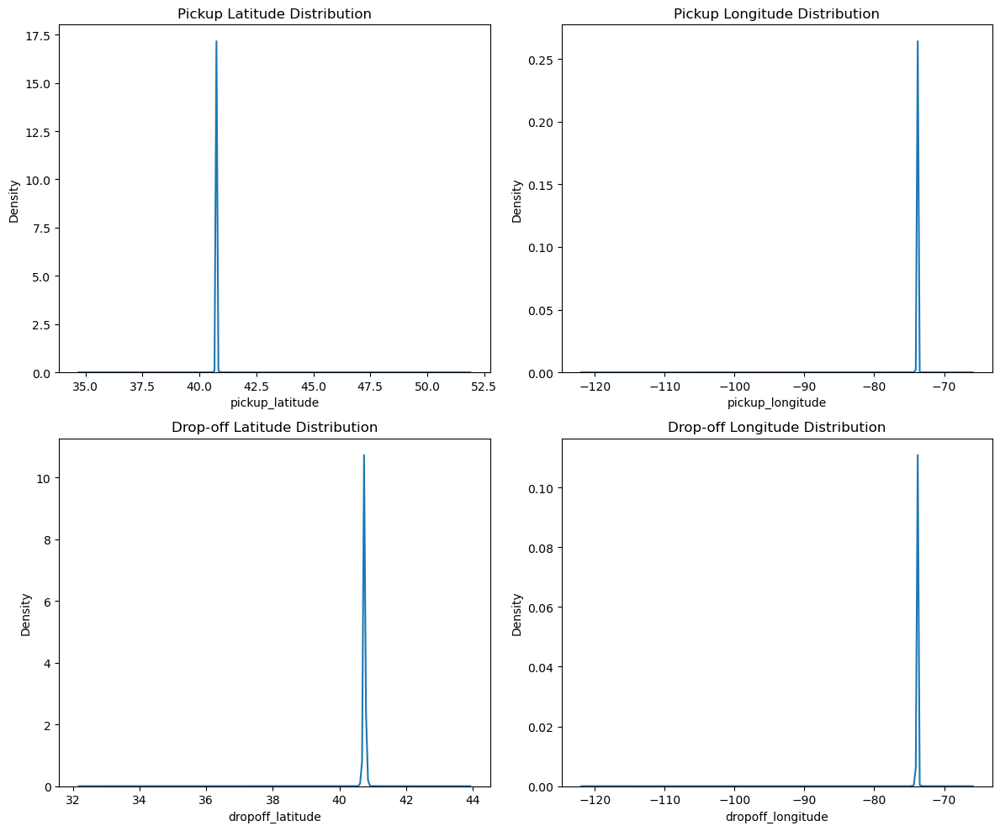

In [19]:
fig, axs = plt.subplots(2, 2, figsize=(12, 10))

# ======pickup latitude distribution================
sns.kdeplot(data['pickup_latitude'], ax=axs[0, 0])
axs[0, 0].set_title('Pickup Latitude Distribution')

# =====pickup longitude distribution==================
sns.kdeplot(data['pickup_longitude'], ax=axs[0, 1])
axs[0, 1].set_title('Pickup Longitude Distribution')

# =====drop-off latitude distribution=================
sns.kdeplot(data['dropoff_latitude'], ax=axs[1, 0])
axs[1, 0].set_title('Drop-off Latitude Distribution')

#==========drop-off longitude distribution=============
sns.kdeplot(data['dropoff_longitude'], ax=axs[1, 1])
axs[1, 1].set_title('Drop-off Longitude Distribution')

#========Adjust the layout of the subplots==============
plt.tight_layout()
plt.show()

## X. Bivariate Relations with Target-After your exploration of related data, plot trip duration against day of the week, and trip duration against hour of the week.


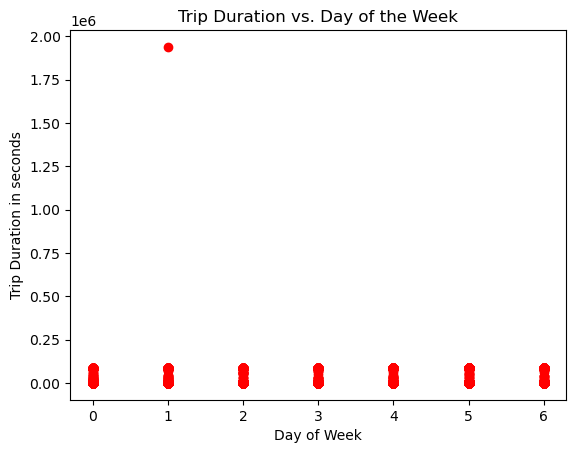

In [20]:
#=======Bivariate Relations with Target-After your exploration of related data,

data["day_of_week"] = data["pickup_datetime"].dt.weekday
data["hour_of_day"] = data["pickup_datetime"].dt.hour




#======plot trip duration against day of the week,===========
plt.scatter(x='day_of_week', y='trip_duration', data=data , color = "red")
plt.xlabel('Day of Week')
plt.ylabel('Trip Duration in seconds')
plt.title('Trip Duration vs. Day of the Week')
plt.show()


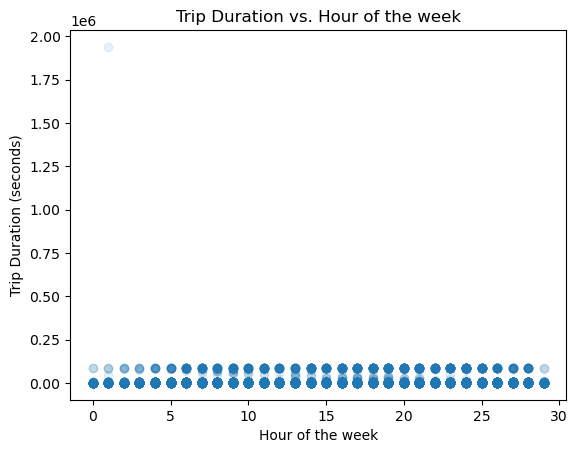

In [101]:
#=============trip duration against hour of the week.==========

data['hour_of_week'] = data['pickup_datetime'].dt.hour + data['pickup_datetime'].dt.dayofweek
plt.scatter(data["hour_of_week"], data["trip_duration"], alpha=0.1)
plt.xlabel("Hour of the week")
plt.ylabel("Trip Duration (seconds)")
plt.title("Trip Duration vs. Hour of the week")
plt.show()

### XI. Plot vendor_id vs Trip Duration


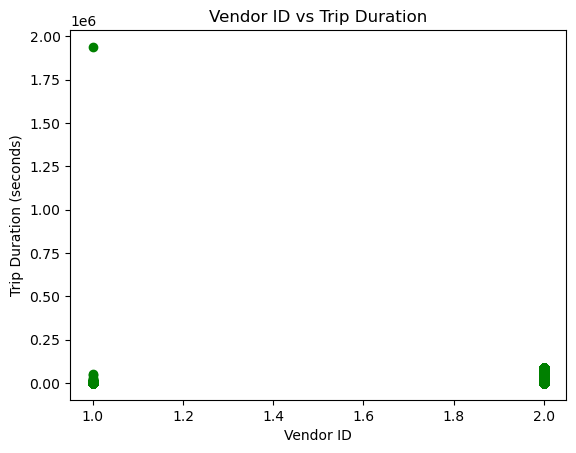

In [21]:

#===========Ploting vendor_id vs Trip Duration=========
plt.scatter(data["vendor_id"], data["trip_duration"] , color = "green")
plt.xlabel("Vendor ID")
plt.ylabel("Trip Duration (seconds)")
plt.title("Vendor ID vs Trip Duration")
plt.show()

##  XII.Find Median Trip Duration Vendor Wise and plot  this line graph

In [1]:
#===Finding Median Trip Duration Vendor Wise and ploting lineplot

grouped_df = data.groupby(["vendor_id", "day_of_week"])["trip_duration"].median().reset_index()

# =======Plot the results as a line ======
sns.lineplot(x="day_of_week", y="trip_duration", hue="vendor_id", data=grouped_df)
plt.xlabel("Day of the Week")
plt.ylabel("Median Trip Duration (seconds)")
plt.title("Median Trip Duration Vendor Wise by Day of the Week")
plt.show()

NameError: name 'data' is not defined

In [ ]:
data.head()

## Determine and if possible plot Trip Duration vs Passenger Count


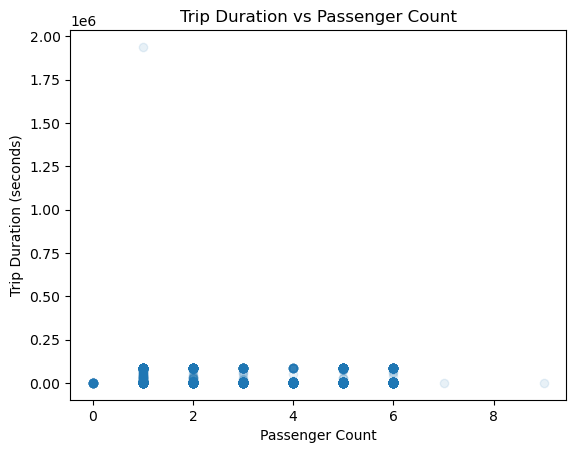

In [23]:
#======Determine and if possible plot Trip Duration vs Passenger Count


plt.scatter(data["passenger_count"], data["trip_duration"], alpha=0.1)
plt.xlabel("Passenger Count")
plt.ylabel("Trip Duration (seconds)")
plt.title("Trip Duration vs Passenger Count")
plt.show()

### Visualise most frequently occuring Pickup points on the latitude-longitude Map and research packages that can provide you with this type of visualization. 


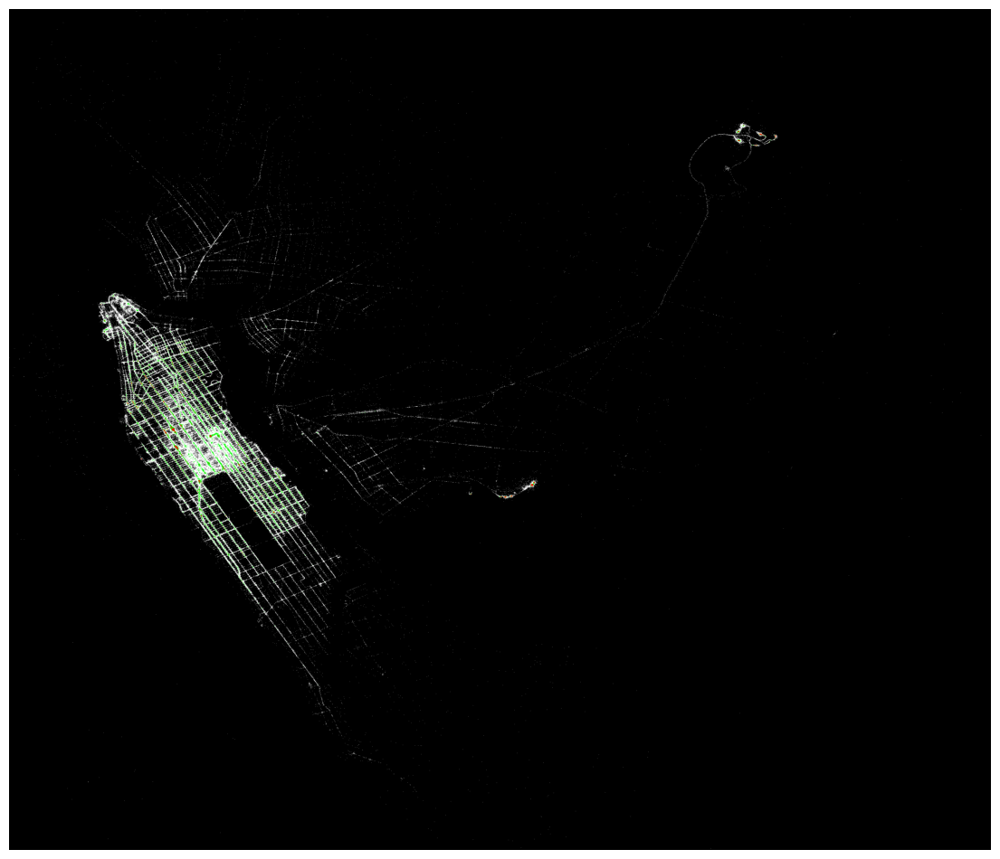

In [24]:
#========Visualise most frequently occuring Pickup points on the latitude-longitude
#====Map and research packages that can provide you with this type of visualization. 

rgb = np.zeros((3000, 3500, 3), dtype=np.uint8)

#black heatmap
rgb[..., 0] = 0
rgb[..., 1] = 0
rgb[..., 2] = 0
df_data_new = data.copy()
df_data_new['pick_lat_new'] = list(map(int, (data['pickup_latitude'] - (40.6000))*10000))
df_data_new['drop_lat_new'] = list(map(int, (data['dropoff_latitude'] - (40.6000))*10000))
df_data_new['pick_lon_new'] = list(map(int, (data['pickup_longitude'] - (-74.050))*10000))
df_data_new['drop_lon_new'] = list(map(int,(data['dropoff_longitude'] - (-74.050))*10000))


summary_plot = pd.DataFrame(df_data_new.groupby(['pick_lat_new', 'pick_lon_new'])['id'].count())


summary_plot.reset_index(inplace=True)

# Loop through each unique latitude value 
lat_list = summary_plot['pick_lat_new'].unique()
for i in lat_list:
  
    lon_list = summary_plot.loc[summary_plot['pick_lat_new'] == i]['pick_lon_new'].tolist()
    unit = summary_plot.loc[summary_plot['pick_lat_new'] == i]['id'].tolist()
    
  
    for j in lon_list:
        # Check if the index values are within the valid range
        if i >= 0 and i < 3000 and j >= 0 and j < 3500:
            a = unit[lon_list.index(j)]
            if (a//25) > 0:
                rgb[i][j][0] = 255
                rgb[i,j, 1] = 0
                rgb[i,j, 2] = 0
            elif (a//10) > 0:
                rgb[i,j, 0] = 0
                rgb[i,j, 1] = 255
                rgb[i,j, 2] = 0
            else:
                rgb[i,j, 0] = 255
                rgb[i,j, 1] = 255
                rgb[i,j, 2] = 255

# Ploting the heatmap 
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(14, 20))
ax.imshow(rgb, cmap='hot')
ax.set_axis_off()
plt.show()

In [25]:
#========Visualise most frequently occuring Pickup points on the latitude-longitude
#====Map and research packages that can provide you with this type of visualization. 



pickup_locations = data[['pickup_latitude', 'pickup_longitude']]

# =====Group by location and count the number of pickups at each location
pickup_counts = pickup_locations.groupby(['pickup_latitude', 'pickup_longitude']).size().reset_index(name='counts')

#==========Sort by most frequent locations
pickup_counts = pickup_counts.sort_values('counts', ascending=False)


pickup_map = folium.Map(location=[40.7589,-73.9851], zoom_start=10) # Starting location is New York City
pickup_heatmap = HeatMap(data=pickup_counts[['pickup_latitude', 'pickup_longitude', 'counts']].values.tolist(), radius=8, max_zoom=13)
pickup_map.add_child(pickup_heatmap)



In [105]:
data.head()

,id,vendor_id,pickup_datetime,dropoff_datetime,passenger_count,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,store_and_fwd_flag,trip_duration,log_trip_duration,pickup_weekday,pickup_hour,hour_of_week
0,id1080784,2,2016-02-29 16:40:21,2016-02-29 16:47:01,1,-73.953918,40.778873,-73.963875,40.771164,0,400,5.993961,0,16,16
1,id0889885,1,2016-03-11 23:35:37,2016-03-11 23:53:57,2,-73.988312,40.731743,-73.994751,40.694931,0,1100,7.003974,4,23,27
2,id0857912,2,2016-02-21 17:59:33,2016-02-21 18:26:48,2,-73.997314,40.721458,-73.948029,40.774918,0,1635,7.400010,6,17,23
3,id3744273,2,2016-01-05 09:44:31,2016-01-05 10:03:32,6,-73.961670,40.759720,-73.956779,40.780628,0,1141,7.040536,1,9,10
4,id0232939,1,2016-02-17 06:42:23,2016-02-17 06:56:31,1,-74.017120,40.708469,-73.988182,40.740631,0,848,6.744059,2,6,8


## Draw Correlation Heatmap

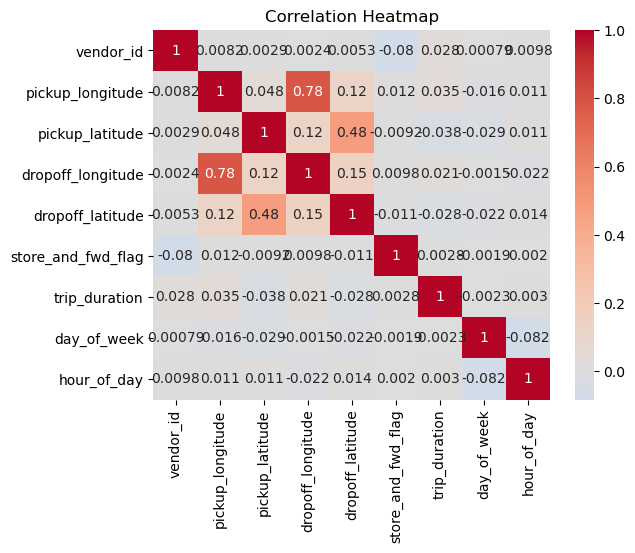

In [26]:
variables = ['vendor_id', 'pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 
             'dropoff_latitude', 'store_and_fwd_flag', 'trip_duration', 'day_of_week', 'hour_of_day']

# =======Create a correlation
corr = data[variables].corr()

#==========Plot the heatmap
sns.heatmap(corr, annot=True, cmap='coolwarm', center=0)
plt.title('Correlation Heatmap')
plt.show()

# DA 02